# analysis and prediction Breast Cancer

about the dataset : 

Features are computed from a digitized image of a fine needle aspirate (FNA) of a breast mass. They describe characteristics of the cell nuclei present in the image.
n the 3-dimensional space is that described in: [K. P. Bennett and O. L. Mangasarian: "Robust Linear Programming Discrimination of Two Linearly Inseparable Sets", Optimization Methods and Software 1, 1992, 23-34].

import Python Libraries : 

In [1]:
import numpy as np
import pandas as pd
from matplotlib import pyplot as plt
import seaborn as sns
import plotly.express as px

## reading data :

In [2]:
df = pd.read_csv(r"C:\Users\nitro 5\Desktop\Breast Cancer Detection\data.csv")
df.head()

,id,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,...,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst,Unnamed: 32
0,842302,M,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.3001,0.14710,...,17.33,184.60,2019.0,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890,NaN
1,842517,M,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.0869,0.07017,...,23.41,158.80,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902,NaN
2,84300903,M,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.1974,0.12790,...,25.53,152.50,1709.0,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758,NaN
3,84348301,M,11.42,20.38,77.58,386.1,0.14250,0.28390,0.2414,0.10520,...,26.50,98.87,567.7,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300,NaN
4,84358402,M,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.1980,0.10430,...,16.67,152.20,1575.0,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678,NaN


In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 569 entries, 0 to 568
Data columns (total 33 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   id                       569 non-null    int64  
 1   diagnosis                569 non-null    object 
 2   radius_mean              569 non-null    float64
 3   texture_mean             569 non-null    float64
 4   perimeter_mean           569 non-null    float64
 5   area_mean                569 non-null    float64
 6   smoothness_mean          569 non-null    float64
 7   compactness_mean         569 non-null    float64
 8   concavity_mean           569 non-null    float64
 9   concave points_mean      569 non-null    float64
 10  symmetry_mean            569 non-null    float64
 11  fractal_dimension_mean   569 non-null    float64
 12  radius_se                569 non-null    float64
 13  texture_se               569 non-null    float64
 14  perimeter_se             5

In [4]:
df.describe()

,id,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,...,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst,Unnamed: 32
count,5.690000e+02,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,...,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,0.0
mean,3.037183e+07,14.127292,19.289649,91.969033,654.889104,0.096360,0.104341,0.088799,0.048919,0.181162,...,25.677223,107.261213,880.583128,0.132369,0.254265,0.272188,0.114606,0.290076,0.083946,NaN
std,1.250206e+08,3.524049,4.301036,24.298981,351.914129,0.014064,0.052813,0.079720,0.038803,0.027414,...,6.146258,33.602542,569.356993,0.022832,0.157336,0.208624,0.065732,0.061867,0.018061,NaN
min,8.670000e+03,6.981000,9.710000,43.790000,143.500000,0.052630,0.019380,0.000000,0.000000,0.106000,...,12.020000,50.410000,185.200000,0.071170,0.027290,0.000000,0.000000,0.156500,0.055040,NaN
25%,8.692180e+05,11.700000,16.170000,75.170000,420.300000,0.086370,0.064920,0.029560,0.020310,0.161900,...,21.080000,84.110000,515.300000,0.116600,0.147200,0.114500,0.064930,0.250400,0.071460,NaN
50%,9.060240e+05,13.370000,18.840000,86.240000,551.100000,0.095870,0.092630,0.061540,0.033500,0.179200,...,25.410000,97.660000,686.500000,0.131300,0.211900,0.226700,0.099930,0.282200,0.080040,NaN
75%,8.813129e+06,15.780000,21.800000,104.100000,782.700000,0.105300,0.130400,0.130700,0.074000,0.195700,...,29.720000,125.400000,1084.000000,0.146000,0.339100,0.382900,0.161400,0.317900,0.092080,NaN
max,9.113205e+08,28.110000,39.280000,188.500000,2501.000000,0.163400,0.345400,0.426800,0.201200,0.304000,...,49.540000,251.200000,4254.000000,0.222600,1.058000,1.252000,0.291000,0.663800,0.207500,NaN


## Dataset Analysis Summary
After examining the dataset using df.info() and df.describe(), the following insights were derived about its structure and features:

Dataset Overview:

The dataset contains 569 rows and 33 columns.
The last column is entirely missing and will be removed, leaving 32 valid columns for analysis.
All 32 valid columns consist of numerical values with a data type of float.
Feature Categories:

The dataset focuses on the cellular characteristics of tumors.
Features are grouped into three primary types:
Mean measurements (e.g., mean_radius, mean_texture)
Standard deviation measurements
Worst-case (largest) measurements (e.g., worst_radius, worst_texture)
Descriptive Statistics:

The descriptive statistics reveal that features such as area_mean and perimeter_mean exhibit significantly larger scales compared to other features.
This disparity aligns with the observation of higher standard deviations in these columns, indicating a need for normalization or scaling before building predictive models.
Mean Features:

The first 10 columns provide mean measurements of tumor characteristics, such as mean_radius and mean_texture.
These mean features represent averaged information about the tumor’s size, shape, and texture.
Worst-Case Features:

The "worst-case" columns describe the largest measurements of the tumor's cellular features.
For instance, the maximum value for area_worst is 4235, whereas the maximum value for area_mean is 2501.
This discrepancy highlights the significant variance in tumor characteristics, particularly in the worst-case scenarios.
These observations provide a foundational understanding of the dataset's structure and feature behavior, which is critical for further preprocessing, exploration, and model development.

### Ratio of Malignant & Bening

In [5]:
mb_grp  = df.groupby('diagnosis')
mb_grp.size()

diagnosis
B    357
M    212
dtype: int64

In [6]:
b_size = mb_grp.size()["B"]
m_size = mb_grp.size()["M"]

b_ratio = round(b_size / df.shape[0] * 100, 2)
m_ratio = round(m_size / df.shape[0] * 100, 2)

print(f"the ration of Malignant tumor is : {m_ratio}%")
print(f"the ratio of Bening tumor is : {b_ratio}%")

the ration of Malignant tumor is : 37.26%
the ratio of Bening tumor is : 62.74%


# EDA

In [7]:
# check for na values
df.isna().sum()

id                           0
diagnosis                    0
radius_mean                  0
texture_mean                 0
perimeter_mean               0
area_mean                    0
smoothness_mean              0
compactness_mean             0
concavity_mean               0
concave points_mean          0
symmetry_mean                0
fractal_dimension_mean       0
radius_se                    0
texture_se                   0
perimeter_se                 0
area_se                      0
smoothness_se                0
compactness_se               0
concavity_se                 0
concave points_se            0
symmetry_se                  0
fractal_dimension_se         0
radius_worst                 0
texture_worst                0
perimeter_worst              0
area_worst                   0
smoothness_worst             0
compactness_worst            0
concavity_worst              0
concave points_worst         0
symmetry_worst               0
fractal_dimension_worst      0
Unnamed:

In [8]:
df.drop(columns=['Unnamed: 32', 'id'], inplace=True)

In [9]:
# check for duplicate values
df[df.duplicated()]

,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,...,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst


In [10]:
sns.pairplot(df, hue='diagnosis')

plt.show()

## Insights from Data Visualization
Using sns.pairplot, the following observations were made regarding the features in the dataset and their effectiveness in distinguishing between benign and malignant tumors:<br>
##### 1 - Highly Distinctive Features:<br>
1-1- radius_mean: This feature shows a clear separation between malignant and benign tumors, making it highly valuable for the model.<br>
1-2-perimeter_mean: Malignant tumors typically have larger perimeters, creating a strong distinction between the two classes.<br>
1-3-area_mean: Malignant tumors tend to have significantly larger areas compared to benign ones, making this feature highly effective.<br>
1-4-concave points_mean: One of the most critical features for differentiation, as malignant tumors exhibit more concave points.<br>
##### 2 - Moderately Distinctive Features:<br>
2-1-texture_mean: While there are visible differences between benign and malignant tumors, the separation is less pronounced compared to features like radius_mean.<br>
2-2-compactness_mean: Displays some distinction between the two classes but is less impactful compared to features like area_mean or perimeter_mean.<br>
2-3-concavity_mean: Malignant tumors tend to have more concave shapes, providing moderate separation.<br>
##### 3 - Less Distinctive Features:<br>
3-1-smoothness_mean: Shows minimal differences between the two classes, indicating it may be less effective for classification.<br>
3-2-symmetry_mean: This feature demonstrates weak separation and might have limited usefulness in distinguishing tumor types.<br>
3-3-fractal_dimension_mean: Displays minimal variation between benign and malignant tumors, suggesting low predictive value.<br>
### Conclusion <br>
Features like radius_mean, perimeter_mean, area_mean, and concave points_mean emerge as the most significant predictors for distinguishing between benign and malignant tumors. Meanwhile, features like symmetry_mean and fractal_dimension_mean may have a limited role in model performance. These insights will guide feature selection and preprocessing in building an effective predictive model.

In [11]:
mean_features  = df[['diagnosis', 'radius_mean', 'texture_mean', 'perimeter_mean',

       'area_mean', 'smoothness_mean', 'compactness_mean', 'concavity_mean',

       'concave points_mean', 'symmetry_mean', 'fractal_dimension_mean']]


se_features = df[['diagnosis', 'radius_se', 'texture_se', 'perimeter_se', 'area_se', 'smoothness_se',

       'compactness_se', 'concavity_se', 'concave points_se', 'symmetry_se',

       'fractal_dimension_se']]


worst_features = df[['diagnosis', 'radius_worst', 'texture_worst',

       'perimeter_worst', 'area_worst', 'smoothness_worst',

       'compactness_worst', 'concavity_worst', 'concave points_worst',

       'symmetry_worst', 'fractal_dimension_worst']]

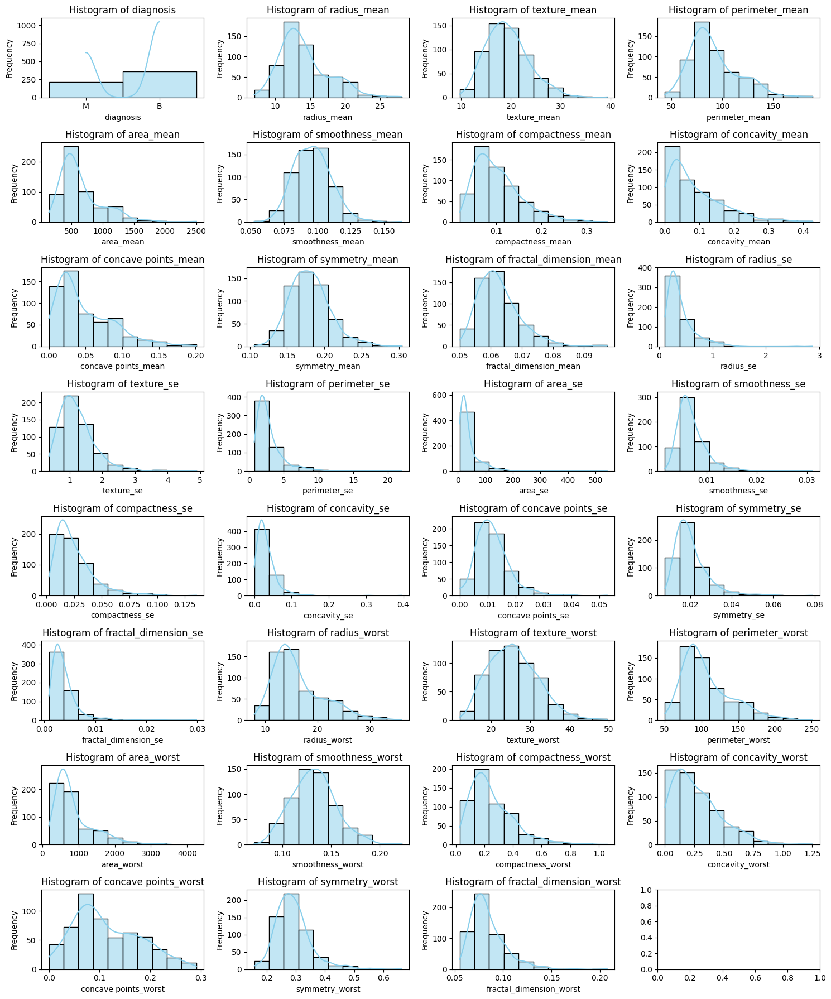

In [12]:
fig,axes = plt.subplots(nrows=8,ncols=4,figsize=(15,18))
column_names=df.columns


for i,column in enumerate(column_names):
    row = i // 4 
    col = i % 4
    sns.histplot(data=df[column], bins=10, color='skyblue',kde=True, edgecolor='black', ax=axes[row, col])
    axes[row, col].set_xlabel(f'{column}')

    axes[row, col].set_ylabel('Frequency')

    axes[row, col].set_title(f'Histogram of {column}')

    

plt.tight_layout()


plt.savefig('foo.png')
plt.show()

 ### Features with Clear Separation and Skewness:
##### radius_mean:
Malignant tumors have higher values for this feature compared to benign tumors.
The distribution appears slightly positively skewed (longer right tail), especially for malignant cases.
##### perimeter_mean:
Similar to radius_mean, malignant tumors exhibit larger values.<br>
This feature is also positively skewed, with most data concentrated on smaller perimeter values.
##### area_mean:
Distinct separation is visible; malignant tumors have significantly larger areas.<br>
The distribution is highly positively skewed, reflecting a few extreme values for malignant tumors.
##### concave points_mean:
Clear separation with malignant tumors having higher values.<br>
The distribution for benign tumors is slightly positively skewed, while malignant cases show more symmetry.
### Features with Moderate Separation:
##### texture_mean:
There’s overlap between the two classes, but malignant tumors tend to have slightly higher values.<br>
The distribution appears slightly positively skewed, though not extreme.
##### compactness_mean:
Malignant tumors generally have higher compactness values, with some overlap.<br>
This feature is positively skewed, particularly for malignant tumors.
##### concavity_mean:
Malignant tumors show more concave shapes, but the feature has notable overlap between classes.<br>
Skewness: Malignant cases are moderately positively skewed, while benign cases are more symmetric.
## Conclusion:
Highly skewed features like area_mean, perimeter_mean, and concave points_mean are strong predictors but will benefit from normalization to reduce the impact of outliers.<br>
Symmetric features with minimal separation (e.g., symmetry_mean, fractal_dimension_mean) may have limited contribution to the model.
Proper handling of skewness and class imbalance will be crucial for building an effective and robust predictive model.
Let me know if you'd like further recommendations for preprocessing or visual adjustments!








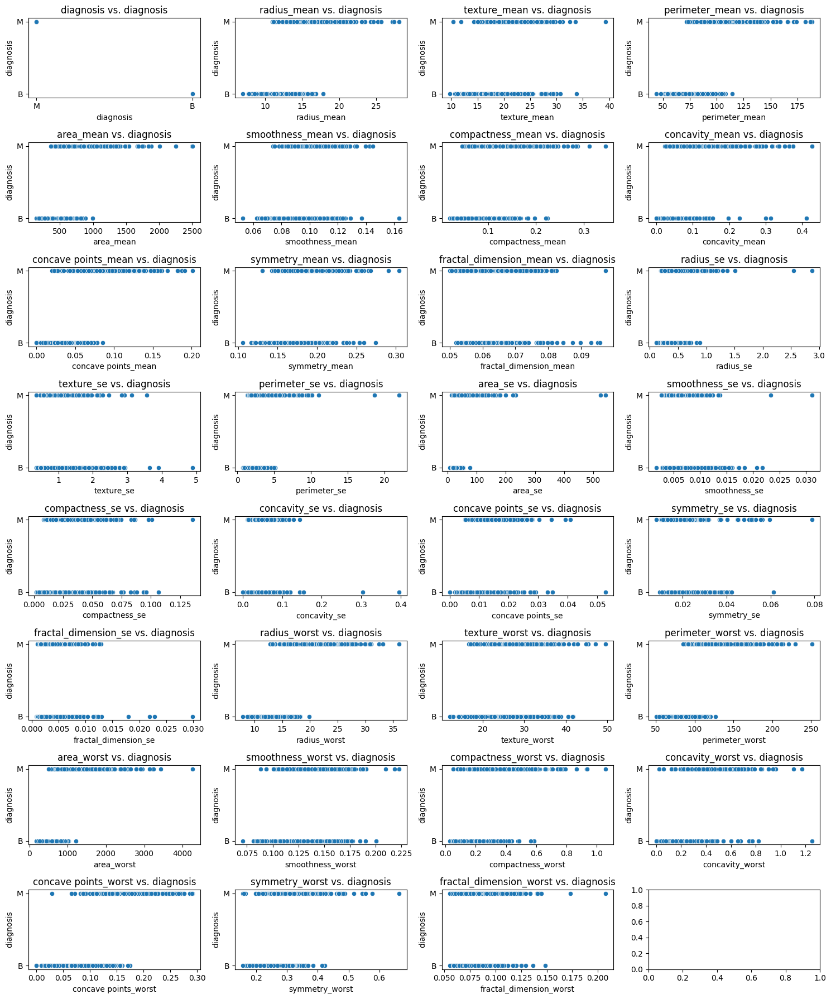

In [13]:
fig,axes = plt.subplots(nrows=8,ncols=4,figsize=(15,18))

column_names=df.columns

for i,column in enumerate(column_names):
    row = i // 4 
    col = i % 4
    sns.scatterplot(x=column,y='diagnosis',data=df,ax=axes[row,col])
    axes[row, col].set_title(f'{column} vs. diagnosis')
plt.tight_layout()
plt.show()

### Mean Features:

1. **radius_mean vs. diagnosis**:

   - Malignant tumors typically have a larger radius, and this feature aids in distinguishing between the two classes.



2. **texture_mean vs. diagnosis**:

   - The difference between benign and malignant in this feature is less pronounced, but as texture increases, the likelihood of malignancy rises.



3. **perimeter_mean vs. diagnosis**:

   - Malignant tumors usually have a larger perimeter. This feature is effective in separating the two classes.



4. **area_mean vs. diagnosis**:

   - Malignant tumors have a larger area, so this feature is useful for identifying malignant tumors.



5. **smoothness_mean vs. diagnosis**:

   - There is a small difference in smoothness between malignant and benign tumors. Smoothness might have limited impact in classification.



6. **compactness_mean vs. diagnosis**:

   - Malignant tumors tend to have higher compactness, but this feature doesn’t create a strong distinction between the two classes.



7. **concavity_mean vs. diagnosis**:

   - Malignant tumors generally have more concavity, which can help in class separation.



8. **concave points_mean vs. diagnosis**:

   - This feature, indicating the number of concave points on the border, creates a very clear difference between benign and malignant tumors.



9. **symmetry_mean vs. diagnosis**:

   - The difference between the two classes is less apparent in symmetry, making it potentially less effective for diagnosis.



10. **fractal_dimension_mean vs. diagnosis**:

   - This feature shows minimal difference between benign and malignant tumors and has limited impact in separation.



### Standard Error Features (`_se`):

These features represent the standard error in measuring each feature and generally indicate data variability:



- Features like `radius_se`, `perimeter_se`, and `area_se` seem more effective in distinguishing between the two classes, as malignant tumors tend to have higher values in these features.

- Other standard error features, such as `smoothness_se` and `symmetry_se`, show minimal difference between benign and malignant tumors.



### Worst Features (`_worst`):

The worst features are also effective in separating the two classes:



1. **radius_worst, perimeter_worst, and area_worst**:

   - Malignant tumors have higher values in these features, providing good separability.



2. **compactness_worst, concavity_worst, and concave points_worst**:

   - These features are also higher in malignant tumors and contribute to diagnosis.



3. **smoothness_worst, symmetry_worst, and fractal_dimension_worst**:

   - These features have a limited impact on distinguishing between benign and malignant tumors, as there’s minimal difference in their values across the two classes.



---



### Overall Conclusion:

Features like `radius_mean`, `perimeter_mean`, `area_mean`, and `concave points_mean` (along with their worst versions) show clear differences between benign and malignant tumors and are likely highly useful for diagnostic models.

<Axes: >

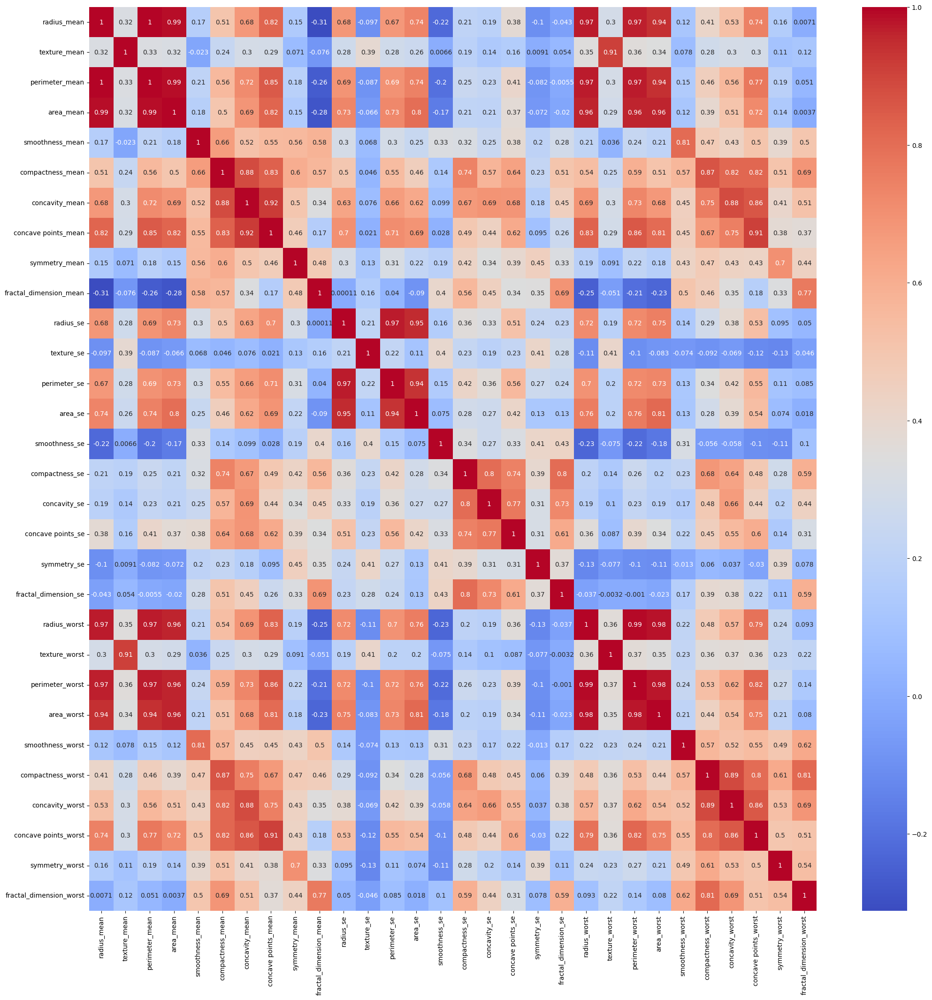

In [14]:
plt.figure(figsize=(25, 25))
df_numeric = df.select_dtypes(include=['float64'])

correlation_matrix = df_numeric.corr()

sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm')

 - In the mean group data, they are dependent on each other, no matter how much or little, but the important thing is that they are dependent on each other

      

 - The texture column does not depend on any of the columns

 

 - Se columns are less dependent on mean columns and they are less dependent on each other than themselves except for area and perimeter columns which have high dependence.

      

 - The worst column is dependent on each other than the mean column, but except for the compactness_mean, concavity_mean, concave points_mean, and radius_mean columns, they are less dependent on the means and have very little dependence on the se columns.

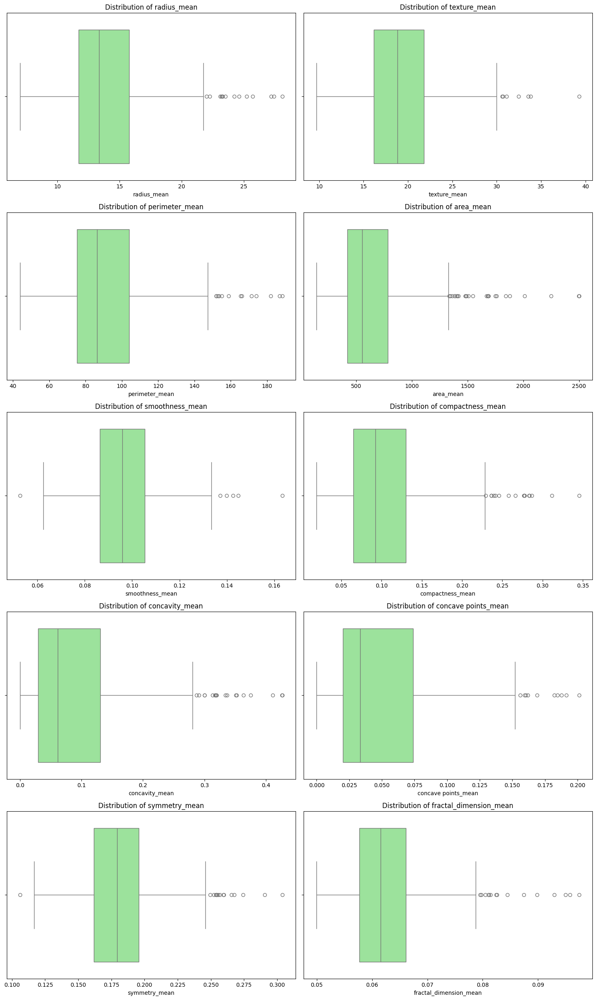

In [15]:
num_plots = len(df_numeric.columns[:10])

num_cols = 2

num_rows = (num_plots // num_cols) + (num_plots % num_cols)



plt.figure(figsize=(15, 5*num_rows))  

for i, col in enumerate(df_numeric.columns[:10], 1):

    plt.subplot(num_rows, num_cols, i)  

    sns.boxplot(x=df_numeric[col], color='lightgreen')

    plt.xlabel(col)

    plt.title(f'Distribution of {col}')

plt.tight_layout()  

plt.show()


### Feature Analysis:

1. **radius_mean**:  

   This feature ranges from approximately 10 to 30, with several outliers on the right (above the third quartile). These outliers might represent larger-than-average tumors. While the data has slight positive skewness, these outliers do not seem to significantly affect the overall distribution.



2. **texture_mean**:  

   Fewer outliers are observed compared to other features. The distribution appears close to normal, and the outliers on both sides have minimal impact on the overall data.



3. **perimeter_mean**:  

   Significant outliers are present on the right, indicating that some samples have substantially larger tumor perimeters than others. The positive skewness of this feature may be notable for modeling purposes.



4. **area_mean**:  

   This feature shows more outliers compared to others and exhibits a significantly right-skewed distribution. The outliers need careful examination, as they may affect the overall analysis.



5. **smoothness_mean**:  

   Few outliers are present, and the distribution appears nearly normal. These outliers are unlikely to have a substantial impact on this feature.



6. **compactness_mean**:  

   There are some outliers on the right, with slight positive skewness. The outliers are not extremely far from the main distribution and could still be included in modeling.



7. **concavity_mean**:  

   This feature also has several outliers on the right, which could indicate specific characteristics of certain samples. A mild positive skewness is present but does not dominate the distribution.



8. **concave points_mean**:  

   Similar to **concavity_mean**, this feature has multiple outliers concentrated on the right. These could be useful in identifying specific tumor characteristics.



9. **symmetry_mean**:  

   The distribution is close to normal, with a few outliers on both sides. These outliers do not significantly alter the overall distribution.



10. **fractal_dimension_mean**:  

    This feature has outliers on the right and shows slight positive skewness. These outliers might influence the distribution but are not extreme.

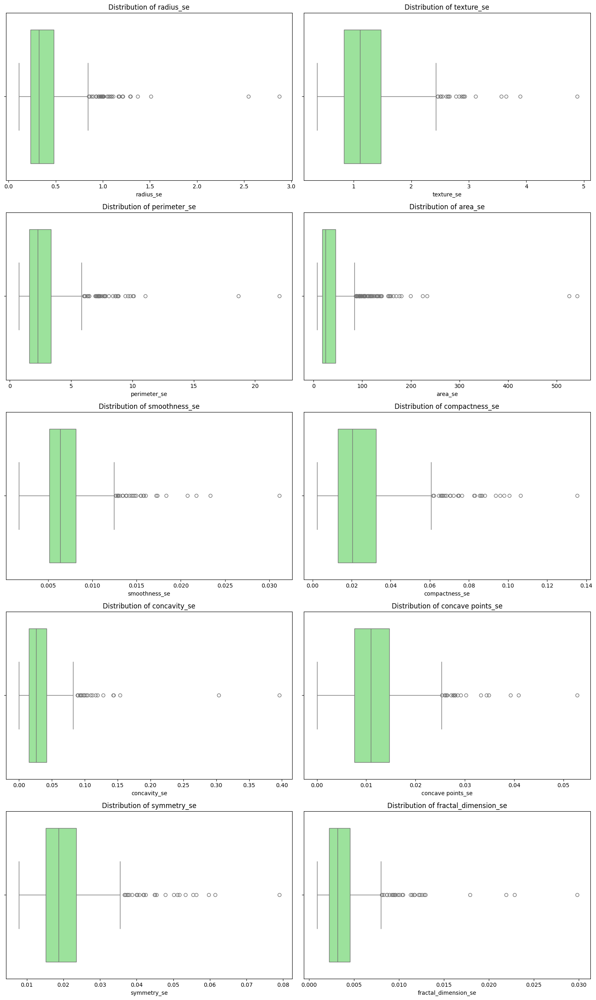

In [16]:
num_plots = len(df_numeric.columns[10:20])

num_cols = 2

num_rows = (num_plots // num_cols) + (num_plots % num_cols)



plt.figure(figsize=(15, 5*num_rows))  

for i, col in enumerate(df_numeric.columns[10:20], 1):

    plt.subplot(num_rows, num_cols, i)  

    sns.boxplot(x=df_numeric[col], color='lightgreen')

    plt.xlabel(col)

    plt.title(f'Distribution of {col}')

plt.tight_layout()  

plt.show()

### Feature Analysis:



1. **radius_se**:

   Contains outliers with positive skewness. The outliers may not heavily influence the distribution, which still reflects the original shape.





2. **texture_se**:

   Positive skewness and presence of outliers. The distribution shape remains consistent, suggesting outliers have limited impact.





3. **perimeter_se**:

   Positive skewness and several outliers. Although these outliers are present, the overall distribution remains similar to the original.





4. **area_se**:

   Outliers and positive skewness are noted. The shape remains largely unaffected by outliers.





5. **smoothness_se**:

   Positive skewness with a few outliers, though they don’t alter the overall distribution.





6. **compactness_se**:

   Positive skewness and outliers are observed. Outliers don’t disrupt the data shape significantly.





7. **concavity_se**:

   Outliers and positive skewness are present, but the distribution shape remains stable.





8. **concave points_se**:

   The distribution appears normal, despite the presence of outliers, indicating minimal impact on data shape.





9. **symmetry_se**:

   Positive skewness with some outliers. The data distribution is largely unaffected by these outliers.





10. **fractal_dimension_se**:

    Positive skewness with outliers that don’t change the general data distribution.


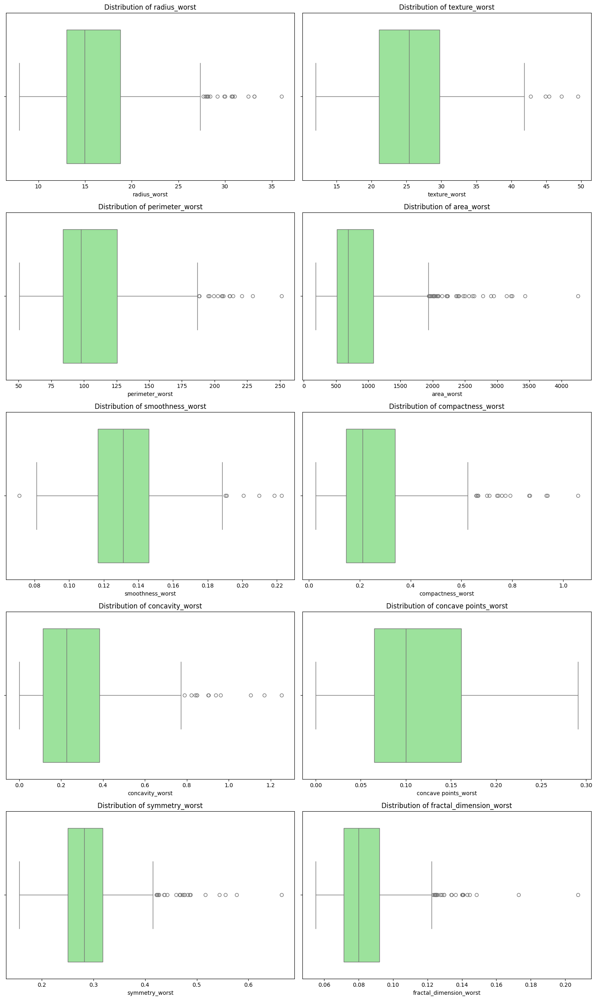

In [17]:
num_plots = len(df_numeric.columns[20:])

num_cols = 2

num_rows = (num_plots // num_cols) + (num_plots % num_cols)



plt.figure(figsize=(15, 5*num_rows))  

for i, col in enumerate(df_numeric.columns[20:], 1):

    plt.subplot(num_rows, num_cols, i)  

    sns.boxplot(x=df_numeric[col], color='lightgreen')

    plt.xlabel(col)

    plt.title(f'Distribution of {col}')

plt.tight_layout()  

plt.show()


### Feature Analysis:



1. **radius_worst**:

   The "radius_worst" column contains outliers and shows positive skewness. This indicates that some values are significantly larger than the mean, but these outliers don’t seem to have a substantial impact on the overall distribution, which remains similar to the original distribution.



2. **texture_worst**:

   This column has outliers, but the distribution remains normal. This suggests that the outliers do not significantly alter the shape of the distribution, and the data retains its original structure.



3. **perimeter_worst**:

   The "perimeter_worst" column contains outliers and has positive skewness. Despite the outliers, the overall distribution remains stable and similar to the original. Outliers do not substantially affect the distribution shape here.



4. **area_worst**:

   The "area_worst" column has outliers, but its distribution appears normal. This indicates that the outliers have minimal impact on the overall distribution, preserving its shape.



5. **smoothness_worst**:

   This column has outliers and positive skewness. However, the overall data distribution remains stable, showing that outliers do not have a major effect on the distribution.



6. **compactness_worst**:

   The "compactness_worst" column has positive skewness and outliers. Despite these outliers, the distribution shape remains consistent with the original distribution, indicating minimal impact from the outliers.



7. **concavity_worst**:

   This column also contains outliers and has positive skewness. Outliers in this column do not significantly affect the overall distribution shape, which remains similar to the original distribution.



8. **concave points_worst**:

   This column shows positive skewness and has no outliers. The distribution is asymmetrical and skewed towards higher values even without any outliers.



9. **symmetry_worst**:

   The "symmetry_worst" column contains outliers, but the distribution remains normal. This indicates that outliers do not significantly alter the distribution, and it maintains its original structure.



10. **fractal_dimension_se**:

    This column has outliers and positive skewness. Despite the presence of outliers, the overall distribution remains similar to the original, showing little effect from these outliers.

In [18]:
diagnosis_int=[]
for i in df['diagnosis'] : 
    if i == "M" : 
        diagnosis_int.append(1)
    elif i == "B" : 
        diagnosis_int.append(0)

In [19]:
df_copy = df.copy()

In [20]:
df_copy['diagnosis_int'] = diagnosis_int

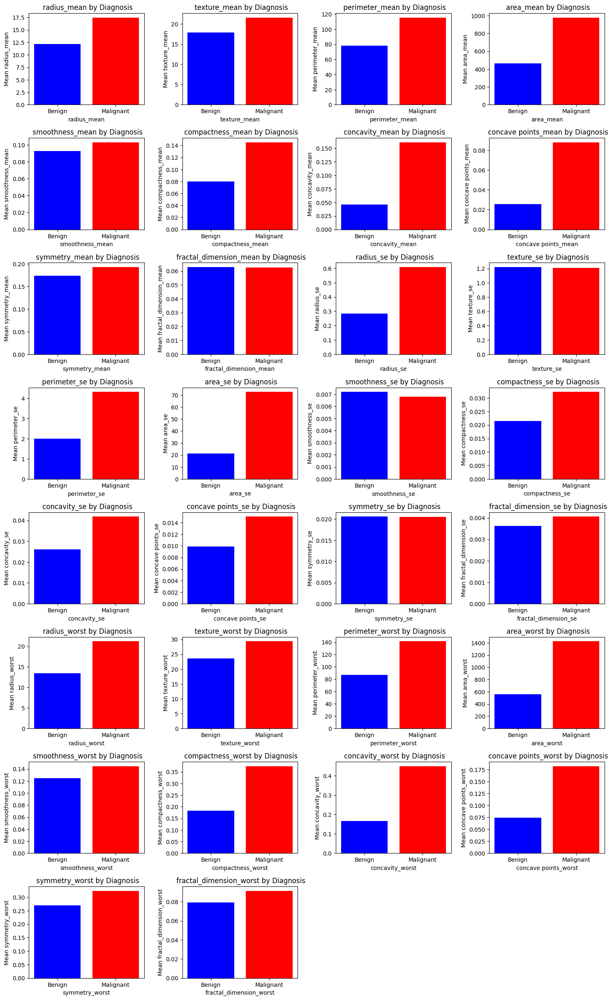

In [21]:
num_plots = len(df_copy.columns[1:31])
num_cols = 4

num_rows = (num_plots // num_cols) + (num_plots % num_cols)



plt.figure(figsize=(15, 3*num_rows))  

for i, col in enumerate(df_copy.columns[1:31], 1):

    plt.subplot(num_rows, num_cols, i)  

    value_mean = df_copy.groupby('diagnosis')[col].mean()

    plt.bar(value_mean.index, value_mean.values, color=['blue','red'])

    plt.xlabel(col)

    plt.ylabel(f'Mean {col}')

    plt.title(f' {col} by Diagnosis')

    plt.xticks(value_mean.index, ['Benign', 'Malignant'])

plt.tight_layout()  

plt.show()


### Summary of analysis:



1. **Highlights:**

 Columns related to size (such as `radius_mean`, `area_mean`) and shape (such as `compactness_mean`, `concavity_mean`) in malignant (M) tumors have higher values ​​than benign (B) and are the most important features for differentiation.



2. **Ineffective features:**

 Columns like `fractal_dimension_mean` and `symmetry_se` show little difference between the two categories and have less impact on detection.



3. **general pattern:**

 In almost all features, the values ​​for malignant tumors are higher.

        

C:\Users\nitro 5\AppData\Local\Temp\ipykernel_16764\13101930.py:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x=col, y='diagnosis', data=df, palette='pastel')
C:\Users\nitro 5\AppData\Local\Temp\ipykernel_16764\13101930.py:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x=col, y='diagnosis', data=df, palette='pastel')
C:\Users\nitro 5\AppData\Local\Temp\ipykernel_16764\13101930.py:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x=col, y='diagnosis', data=df, palette='pastel')
C:\Users\nitro 5\AppData\Local\Temp\ipykernel_16764\13101930.

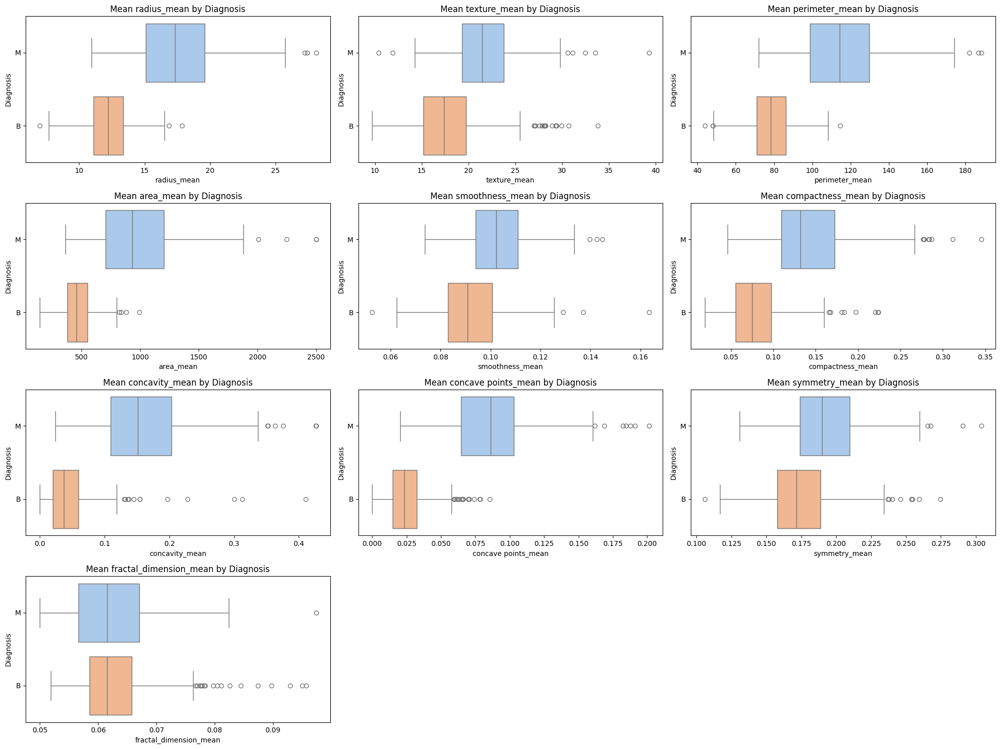

In [22]:
plt.figure(figsize=(20, 15))
mean_columns = df_numeric.columns[:10]

for i, col in enumerate(mean_columns, 1):

    plt.subplot(4, 3, i)

    sns.boxplot(x=col, y='diagnosis', data=df, palette='pastel')

    plt.title(f'Mean {col} by Diagnosis')

    plt.xlabel(col)

    plt.ylabel('Diagnosis')



plt.tight_layout()

plt.show()


Summary of the analysis:



- Most features (like `radius_mean`, `texture_mean`, `perimeter_mean`, etc.) have different distributions for **malignant (M)** and **benign (B)** tumors.

- Many features contain **outliers**, which could be important signals for distinguishing between tumor types.

- Features with a **normal distribution** (e.g., `radius_mean`, `texture_mean`, `fractal_dimension_mean`) might be more useful for classification models.

- Features with **positive or negative skewness** (e.g., `perimeter_mean`, `area_mean`, `concave_points_mean`) may require further preprocessing, such as **log transformation**.


C:\Users\nitro 5\AppData\Local\Temp\ipykernel_16764\1760197343.py:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x=col, y='diagnosis', data=df, palette='pastel')
C:\Users\nitro 5\AppData\Local\Temp\ipykernel_16764\1760197343.py:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x=col, y='diagnosis', data=df, palette='pastel')
C:\Users\nitro 5\AppData\Local\Temp\ipykernel_16764\1760197343.py:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x=col, y='diagnosis', data=df, palette='pastel')
C:\Users\nitro 5\AppData\Local\Temp\ipykernel_16764\176

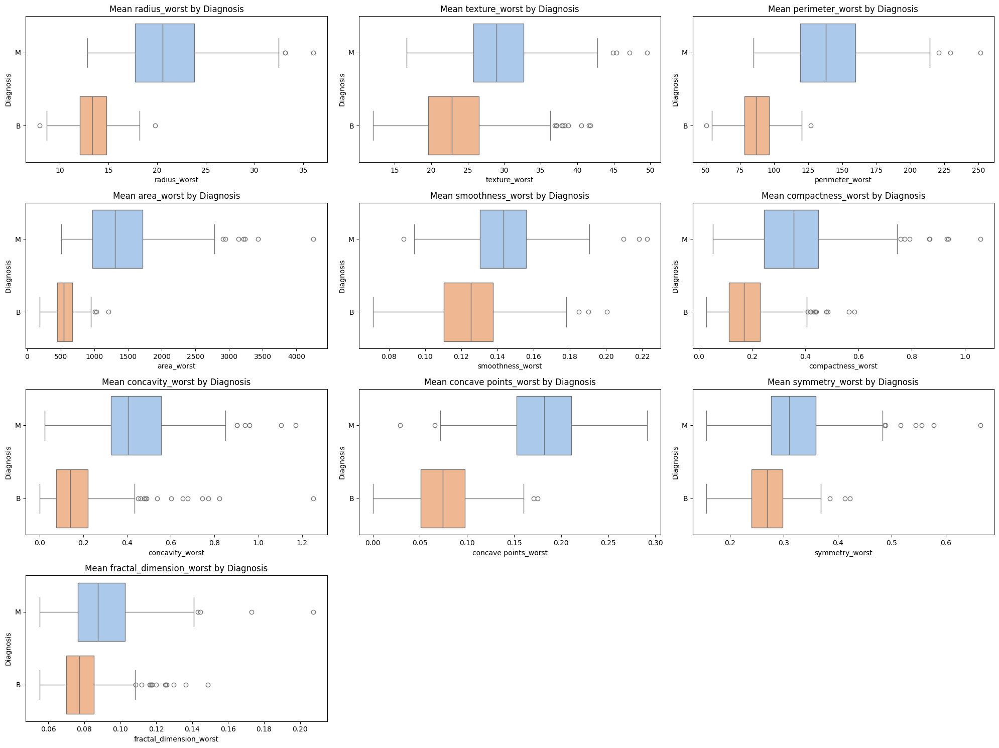

In [23]:
plt.figure(figsize=(20, 15))
wr_columns = df_numeric.columns[20:]

for i, col in enumerate(wr_columns, 1):

    plt.subplot(4, 3, i)

    sns.boxplot(x=col, y='diagnosis', data=df, palette='pastel')

    plt.title(f'Mean {col} by Diagnosis')

    plt.xlabel(col)

    plt.ylabel('Diagnosis')



plt.tight_layout()

plt.show()


### Summary:



- Many features (e.g., `radius_worst`, `texture_worst`, `perimeter_worst`) have **normal distributions** with outliers for both malignant and benign tumors.

- Some features (e.g., `area_worst`, `smoothness_worst`, `fractal_dimension_worst`) have **skewed distributions** (positive or negative) and may need **log transformations**.

- **Outliers** are present in many features and might be significant for distinguishing between malignant and benign tumors.

In [24]:
df_M=df[df['diagnosis']=='M']

In [25]:
df_B = df[df['diagnosis'] == "B"]

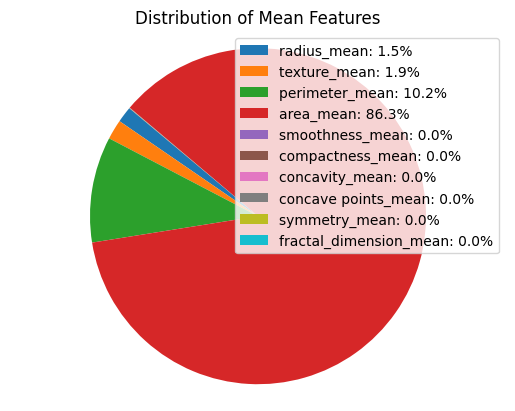

In [26]:
mean_percentages = df_M[mean_columns].mean() / df_M[mean_columns].mean().sum() * 100
mean_percentages




plt.pie(mean_percentages, startangle=140)

plt.title('Distribution of Mean Features')

plt.axis('equal')  





plt.legend(labels=[f'{label}: {value:.1f}%' for label, value in zip(mean_percentages.index, mean_percentages)], loc='upper right')

plt.show()

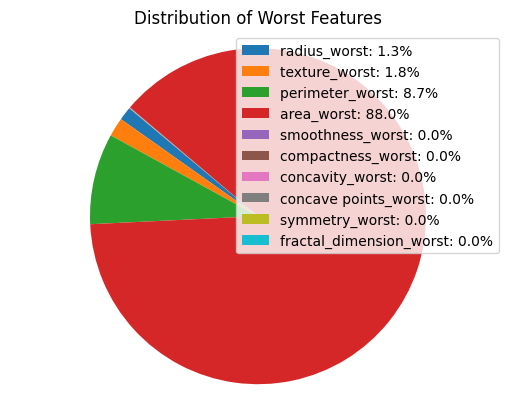

In [27]:
w_percentages = df_M[wr_columns].mean() / df_M[wr_columns].mean().sum() * 100





plt.pie(w_percentages, startangle=140)

plt.title('Distribution of Worst Features')

plt.axis('equal')  





plt.legend(labels=[f'{label}: {value:.1f}%' for label, value in zip(w_percentages.index, w_percentages)], loc='upper right')

plt.show()

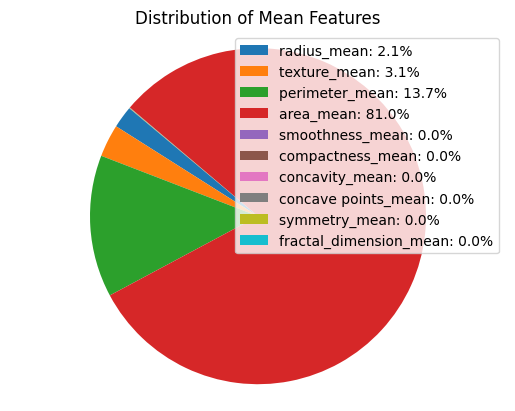

In [28]:
mean_percentages = df_B[mean_columns].mean() / df_B[mean_columns].mean().sum() * 100





plt.pie(mean_percentages, startangle=140)

plt.title('Distribution of Mean Features')

plt.axis('equal')  





plt.legend(labels=[f'{label}: {value:.1f}%' for label, value in zip(mean_percentages.index, mean_percentages)], loc='upper right')

plt.show()

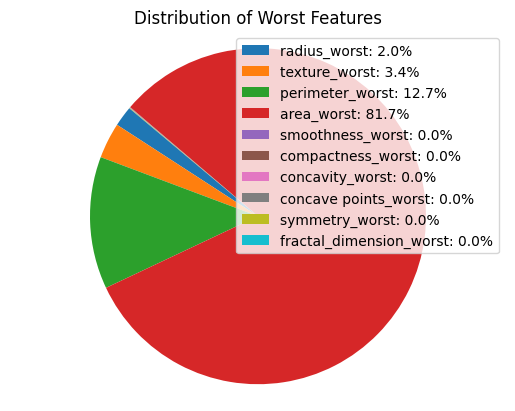

In [29]:
    w_percentages = df_B[wr_columns].mean() / df_B[wr_columns].mean().sum() * 100





plt.pie(w_percentages, startangle=140)

plt.title('Distribution of Worst Features')

plt.axis('equal')  





plt.legend(labels=[f'{label}: {value:.1f}%' for label, value in zip(w_percentages.index, w_percentages)], loc='upper right')

plt.show()

<p style = "font-size:150%; color:#226666">💡 Result </p> 



These graphs show that the `area_mean` feature in all the graphs contributes the most **over 80%** to the distribution and is probably the most important feature in the data. The features `perimeter_mean` and `texture_mean` are also of moderate importance, but the rest of the features contribute very little and may not have much impact on the model. This distribution can be useful for selecting key features and reducing less effective features in the analysis.

# Modeling

In [30]:
from sklearn.preprocessing import StandardScaler

from sklearn.model_selection import train_test_split

from sklearn.metrics import accuracy_score

from sklearn.naive_bayes import GaussianNB

from sklearn.ensemble import RandomForestClassifier

from sklearn.metrics import confusion_matrix

from sklearn.ensemble import RandomForestClassifier

from sklearn.linear_model import LogisticRegression

from sklearn.metrics import accuracy_score,f1_score,recall_score,precision_score

from sklearn.preprocessing import LabelEncoder

from sklearn.tree import DecisionTreeRegressor

from sklearn.tree import DecisionTreeClassifier

from sklearn.neighbors import KNeighborsClassifier 

In [31]:
X0 = df[['radius_mean', 'texture_mean', 'perimeter_mean',

       'area_mean', 'smoothness_mean', 'compactness_mean', 'concavity_mean',

       'concave points_mean', 'symmetry_mean', 'fractal_dimension_mean']]

y0 = df['diagnosis']  

In [32]:
models = ['Model GaussianNB', 'Model RandomForest', 'Model LogisticRegression','Model DecisionTreeClassifier',
         'Model KNeighborsClassifier']

In [33]:
label_encoder = LabelEncoder()

y= label_encoder.fit_transform(y0)

In [34]:
scaler=StandardScaler()

x=scaler.fit_transform(X0)
x

array([[ 1.09706398e+00, -2.07333501e+00,  1.26993369e+00, ...,
         2.53247522e+00,  2.21751501e+00,  2.25574689e+00],
       [ 1.82982061e+00, -3.53632408e-01,  1.68595471e+00, ...,
         5.48144156e-01,  1.39236330e-03, -8.68652457e-01],
       [ 1.57988811e+00,  4.56186952e-01,  1.56650313e+00, ...,
         2.03723076e+00,  9.39684817e-01, -3.98007910e-01],
       ...,
       [ 7.02284249e-01,  2.04557380e+00,  6.72675785e-01, ...,
         1.05777359e-01, -8.09117071e-01, -8.95586935e-01],
       [ 1.83834103e+00,  2.33645719e+00,  1.98252415e+00, ...,
         2.65886573e+00,  2.13719425e+00,  1.04369542e+00],
       [-1.80840125e+00,  1.22179204e+00, -1.81438851e+00, ...,
        -1.26181958e+00, -8.20069901e-01, -5.61032377e-01]])

In [35]:
X=np.array(x)

Y=np.array(y)

In [36]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [37]:
acc_test=[]

acc_train=[]

pre=[]

re=[]

f1=[]

y_pr=[]

In [38]:
model = GaussianNB()



model.fit(X_train, y_train)



y_p_test1 = model.predict(X_test)

y_p_train1 = model.predict(X_train)

In [39]:
y_test1=y_test

y_train1=y_train

In [40]:
acc_test1 = accuracy_score(y_test1, y_p_test1)

acc_train1 = accuracy_score(y_train1, y_p_train1)

print("Accuracy Test:", acc_test1,"Accuracy Train:",acc_train1)

Accuracy Test: 0.9385964912280702 Accuracy Train: 0.9098901098901099


In [41]:
precision1 = precision_score(y_test1, y_p_test1, average='macro')

recall1 = recall_score(y_test1, y_p_test1, average='macro')

f1_1 = f1_score(y_test1, y_p_test1, average='macro')



print("Precision:", precision1)

print("Recall:", recall1 )

print("F1_Score:", f1_1)

Precision: 0.9412162162162162
Recall: 0.9277759580740256
F1_Score: 0.933693394266722


In [42]:
acc_test.append(acc_test1)

acc_train.append(acc_train1)

pre.append(precision1)

re.append(recall1)

f1.append(f1_1)

y_pr.append(y_p_test1)

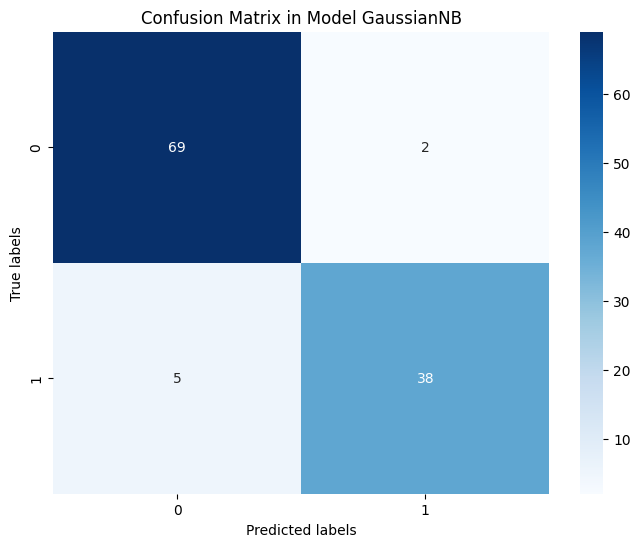

In [43]:
conf_matrix = confusion_matrix(y_test1, y_p_test1)



plt.figure(figsize=(8, 6))

sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues')

plt.xlabel('Predicted labels')

plt.ylabel('True labels')

plt.title(f'Confusion Matrix in {models[0]}')

plt.show()

# Random Forest

In [44]:
rf = RandomForestClassifier(n_estimators=6, random_state=42)



rf.fit(X_train, y_train)



y_p_test2 = rf.predict(X_test)

y_p_train2 = rf.predict(X_train)

In [45]:
acc_test2 = accuracy_score(y_test1, y_p_test2)

acc_train2 = accuracy_score(y_train1, y_p_train2)

print("Accuracy Test:", acc_test2,"Accuracy Train:",acc_train2)

Accuracy Test: 0.9649122807017544 Accuracy Train: 0.9824175824175824


In [46]:
precision2 = precision_score(y_test, y_p_test2, average='macro')

recall2 = recall_score(y_test, y_p_test2, average='macro')

f1_2 = f1_score(y_test, y_p_test2, average='macro')



print("Precision:", precision2)

print("Recall:", recall2)

print("F1_Score:", f1_2)

Precision: 0.9672569328433009
Recall: 0.9580740255486406
F1_Score: 0.9623015873015872


In [47]:
acc_test.append(acc_test2)

acc_train.append(acc_train2)

pre.append(precision2)

re.append(recall2)

f1.append(f1_2)

y_pr.append(y_p_test2)

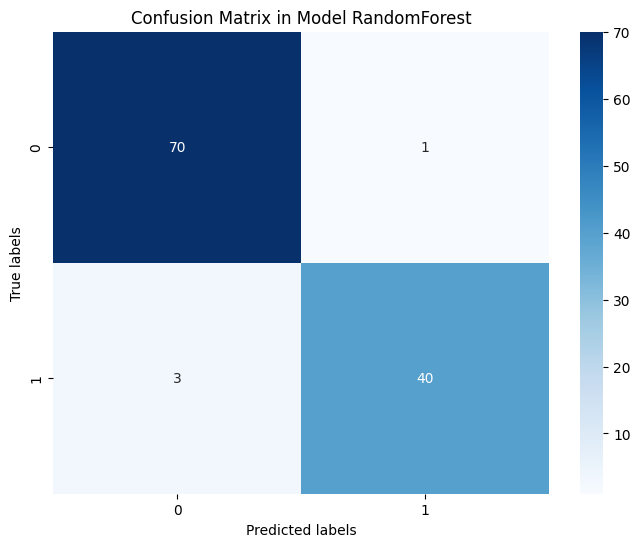

In [48]:
conf_matrix = confusion_matrix(y_test, y_p_test2)





plt.figure(figsize=(8, 6))

sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues')

plt.xlabel('Predicted labels')

plt.ylabel('True labels')

plt.title(f'Confusion Matrix in {models[1]}')

plt.show()

# Logestic and Linear Regression 

In [49]:
lg = LogisticRegression()





lg.fit(X_train, y_train)



y_p_test3 = lg.predict(X_test)

y_p_train3 = lg.predict(X_train)

In [50]:
acc_test3 = accuracy_score(y_test, y_p_test3)

acc_train3 = accuracy_score(y_train, y_p_train3)

print("Accuracy Test:", acc_test3,"Accuracy Train:",acc_train3)

Accuracy Test: 0.9385964912280702 Accuracy Train: 0.9428571428571428


In [51]:
precision3 = precision_score(y_test, y_p_test3, average='macro')

recall3 = recall_score(y_test, y_p_test3, average='macro')

f1_3 = f1_score(y_test, y_p_test3, average='macro')



print("Precision:", precision3)

print("Recall:", recall3)

print("F1_Score:", f1_3)

Precision: 0.9365079365079365
Recall: 0.9323616115296429
F1_Score: 0.9343480049362403


In [52]:
acc_test.append(acc_test3)

acc_train.append(acc_train3)

pre.append(precision3)

re.append(recall3)

f1.append(f1_3)

y_pr.append(y_p_test3)

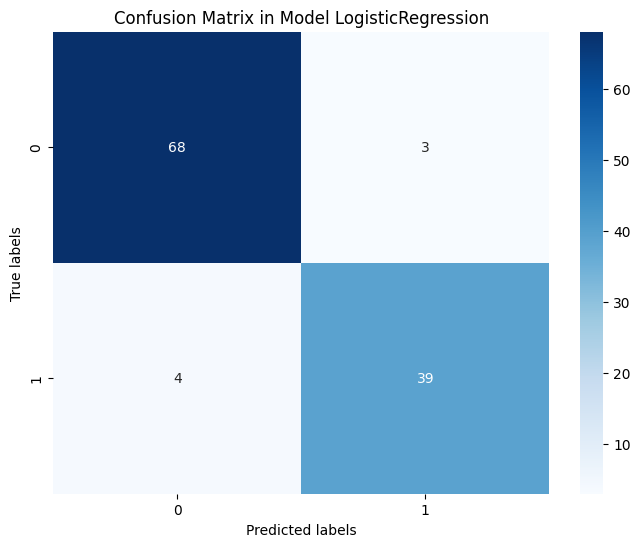

In [53]:
conf_matrix = confusion_matrix(y_test, y_p_test3)





plt.figure(figsize=(8, 6))

sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues')

plt.xlabel('Predicted labels')

plt.ylabel('True labels')

plt.title(f'Confusion Matrix in {models[2]}')

plt.show()

# Decision Tree classifier

In [54]:
dt = DecisionTreeClassifier(max_depth=4,min_samples_leaf=6,min_samples_split=6)

dt.fit(X_train, y_train)



y_p_test4 = dt.predict(X_test)

y_p_train4 = dt.predict(X_train)

In [55]:
acc_test4 = accuracy_score(y_test, y_p_test4)

acc_train4 = accuracy_score(y_train, y_p_train4)

print("Accuracy Test:", acc_test4,"Accuracy Train:",acc_train4)

Accuracy Test: 0.9649122807017544 Accuracy Train: 0.9648351648351648


In [56]:
precision4 = precision_score(y_test, y_p_test4, average='macro')

recall4 = recall_score(y_test, y_p_test4, average='macro')

f1_4 = f1_score(y_test, y_p_test4, average='macro')



print("Precision:", precision4)

print("Recall:", recall4)

print("F1_Score:", f1_4)

Precision: 0.9672569328433009
Recall: 0.9580740255486406
F1_Score: 0.9623015873015872


In [57]:
acc_test.append(acc_test4)

acc_train.append(acc_train4)

pre.append(precision4)

re.append(recall4)

f1.append(f1_4)

y_pr.append(y_p_test4)

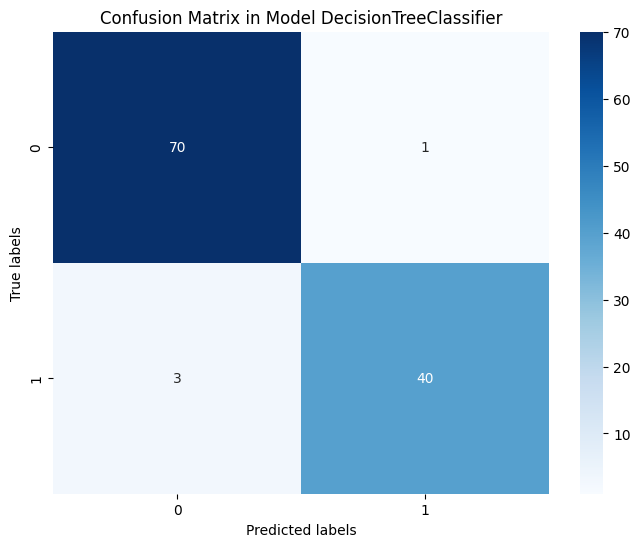

In [58]:
conf_matrix = confusion_matrix(y_test, y_p_test4)





plt.figure(figsize=(8, 6))

sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues')

plt.xlabel('Predicted labels')

plt.ylabel('True labels')

plt.title(f'Confusion Matrix in {models[3]}')

plt.show()

# KNeighborsClassifier

In [59]:
knn = KNeighborsClassifier(n_neighbors=4)

In [60]:
knn.fit(X_train, y_train)



y_p_test5 = knn.predict(X_test)

y_p_train5 = knn.predict(X_train)

In [61]:
acc_test5 = accuracy_score(y_test, y_p_test5)

acc_train5 = accuracy_score(y_train, y_p_train5)

print("Accuracy Test:", acc_test5,"Accuracy Train:",acc_train5)

Accuracy Test: 0.956140350877193 Accuracy Train: 0.9538461538461539


In [62]:
precision5 = precision_score(y_test, y_p_test5, average='macro')

recall5 = recall_score(y_test, y_p_test5, average='macro')

f1_5 = f1_score(y_test, y_p_test5, average='macro')



print("Precision:", precision5)

print("Recall:", recall5)

print("F1_Score:", f1_5)

Precision: 0.960472972972973
Recall: 0.9464461185718964
F1_Score: 0.9526381387619444


In [63]:
acc_test.append(acc_test5)

acc_train.append(acc_train5)

pre.append(precision5)

re.append(recall5)

f1.append(f1_5)

y_pr.append(y_p_test5)

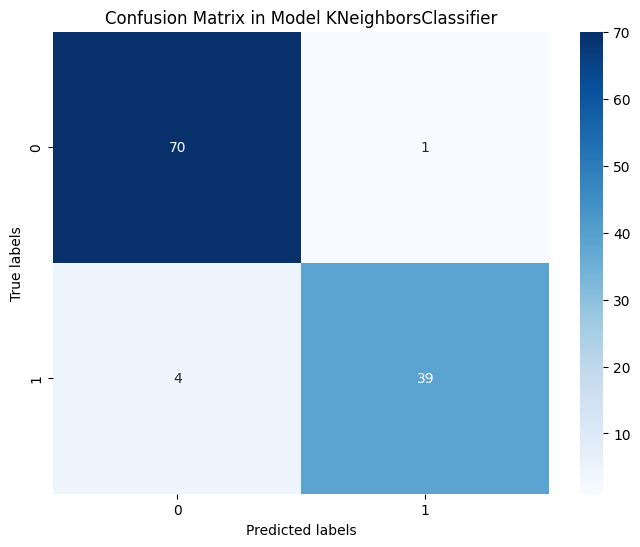

In [64]:
conf_matrix = confusion_matrix(y_test, y_p_test5)





plt.figure(figsize=(8, 6))

sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues')

plt.xlabel('Predicted labels')

plt.ylabel('True labels')

plt.title(f'Confusion Matrix in {models[4]}')

plt.show()

# Result 

In [65]:
d={'Models':models,'Accuracy Test':acc_test,'Accuracy Train':acc_train,'Precision':pre,'Recall':re,'F1_Score':f1}

In [66]:
mo_df=pd.DataFrame(d)

In [67]:
mo_df

,Models,Accuracy Test,Accuracy Train,Precision,Recall,F1_Score
0,Model GaussianNB,0.938596,0.909890,0.941216,0.927776,0.933693
1,Model RandomForest,0.964912,0.982418,0.967257,0.958074,0.962302
2,Model LogisticRegression,0.938596,0.942857,0.936508,0.932362,0.934348
3,Model DecisionTreeClassifier,0.964912,0.964835,0.967257,0.958074,0.962302
4,Model KNeighborsClassifier,0.956140,0.953846,0.960473,0.946446,0.952638


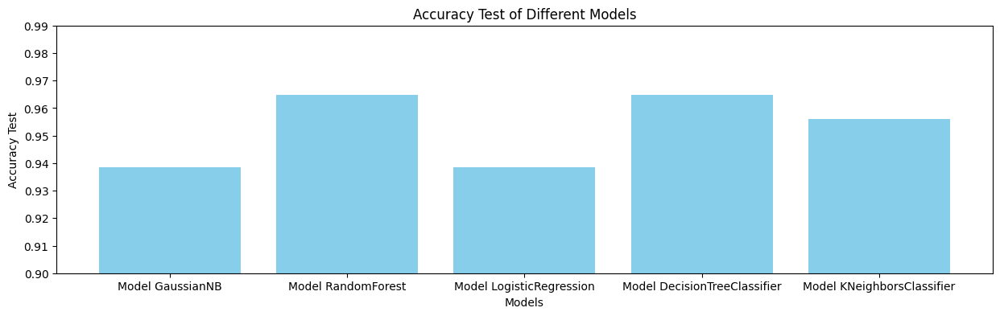

In [68]:
plt.figure(figsize=(15, 4))

plt.bar(models, acc_test, color='skyblue')

plt.xlabel('Models')

plt.ylabel('Accuracy Test')

plt.title('Accuracy Test of Different Models')

plt.ylim(0.90, 0.99)  

plt.show()

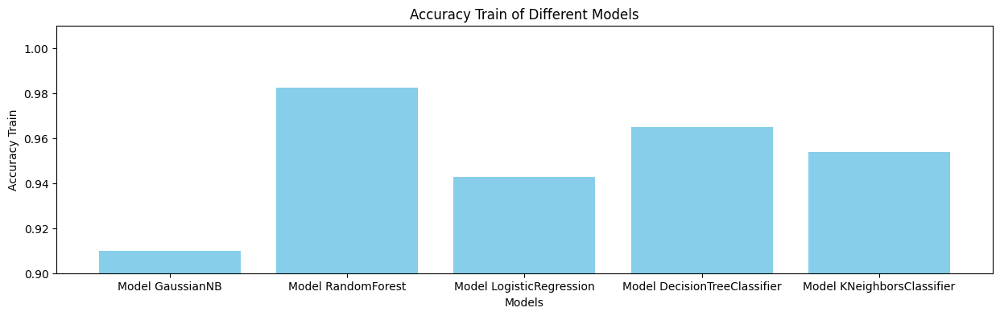

In [69]:
plt.figure(figsize=(15, 4))

plt.bar(models, acc_train, color='skyblue')

plt.xlabel('Models')

plt.ylabel('Accuracy Train')

plt.title('Accuracy Train of Different Models')

plt.ylim(0.90, 1.01)  

plt.show()

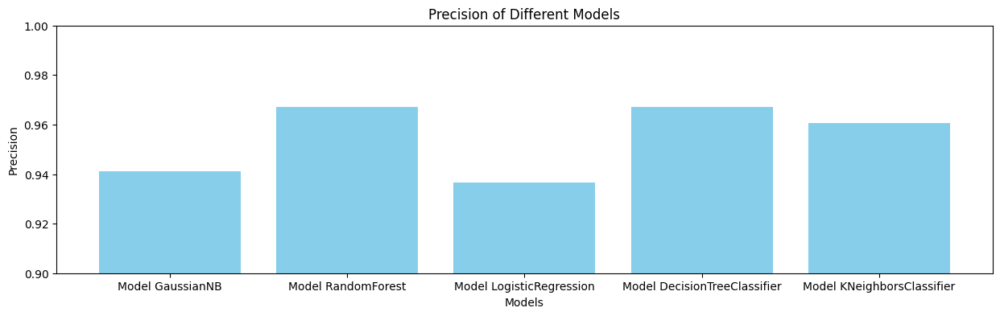

In [70]:
plt.figure(figsize=(15, 4))

plt.bar(models, pre, color='skyblue')

plt.xlabel('Models')

plt.ylabel('Precision')

plt.title('Precision of Different Models')

plt.ylim(0.90, 1.0)  

plt.show()

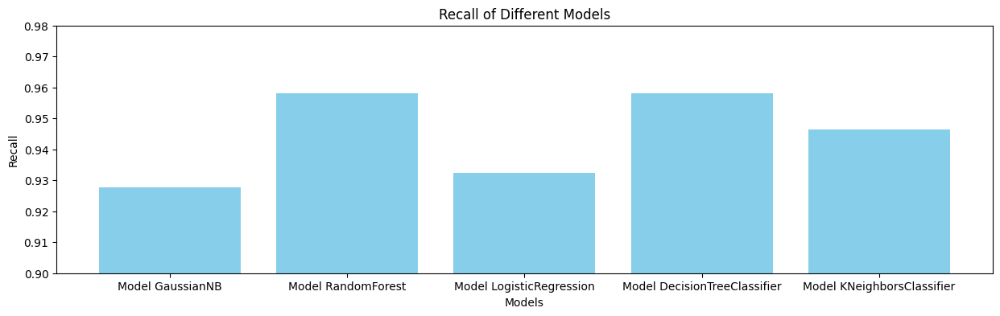

In [71]:
plt.figure(figsize=(15, 4))

plt.bar(models, re, color='skyblue')

plt.xlabel('Models')

plt.ylabel('Recall')

plt.title('Recall of Different Models')

plt.ylim(0.90, 0.98)  

plt.show()

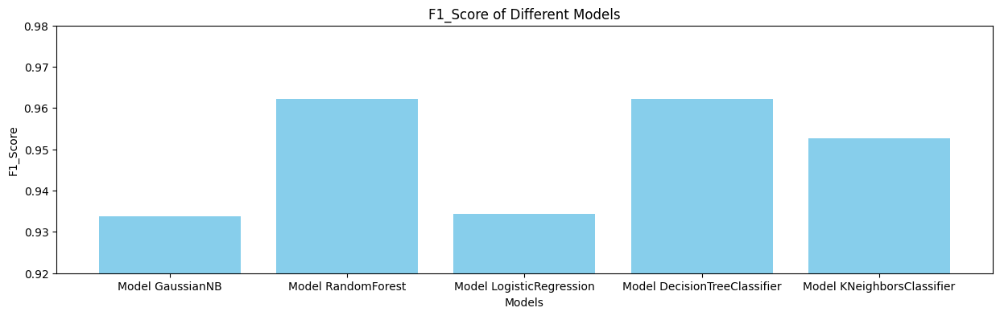

In [72]:
plt.figure(figsize=(15, 4))

plt.bar(models, f1, color='skyblue')

plt.xlabel('Models')

plt.ylabel('F1_Score')

plt.title('F1_Score of Different Models')

plt.ylim(0.92, 0.98)  

plt.show()

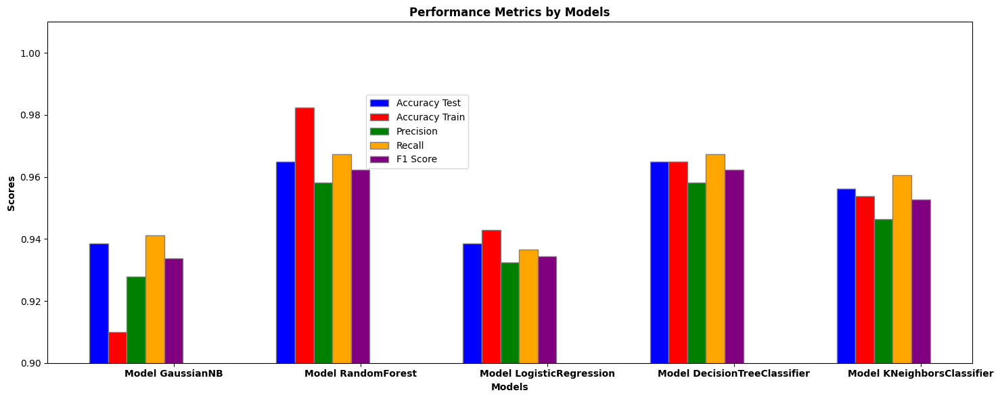

In [73]:
plt.figure(figsize=(15, 6))



barWidth = 0.10

r1 = np.arange(len(mo_df))

r2 = [x + barWidth for x in r1]

r3 = [x + barWidth for x in r2]

r4 = [x + barWidth for x in r3]

r5 = [x + barWidth for x in r4]



plt.bar(r1, mo_df['Accuracy Test'], color='blue', width=barWidth, edgecolor='grey', label='Accuracy Test')

plt.bar(r2, mo_df['Accuracy Train'], color='red', width=barWidth, edgecolor='grey', label='Accuracy Train')

plt.bar(r3, mo_df['Recall'], color='green', width=barWidth, edgecolor='grey', label='Precision')

plt.bar(r4, mo_df['Precision'], color='orange', width=barWidth, edgecolor='grey', label='Recall')

plt.bar(r5, mo_df['F1_Score'], color='purple', width=barWidth, edgecolor='grey', label='F1 Score')







plt.xlabel('Models', fontweight='bold')

plt.xticks([r + barWidth*4 for r in range(len(mo_df))], mo_df['Models'], fontweight='bold')

plt.ylabel('Scores', fontweight='bold')



plt.title('Performance Metrics by Models', fontweight='bold')





plt.legend()

plt.legend(bbox_to_anchor=(0.4, 0.8), loc='upper center')

plt.ylim(0.90, 1.01)

plt.tight_layout()

plt.show()

In [74]:
def plot_actual_vs_predicted(y_true, y_pred,na):

    plt.figure(figsize=(8, 6))

    plt.scatter(range(len(y_true)), y_true, color='b', label='Actual')

    plt.scatter(range(len(y_pred)), y_pred, color='r', label='Predicted')

    plt.xlabel('Sample Index')

    plt.ylabel('Target Value')

    plt.title(f'Actual vs Predictedm in {na}')

    plt.legend()

    plt.show()

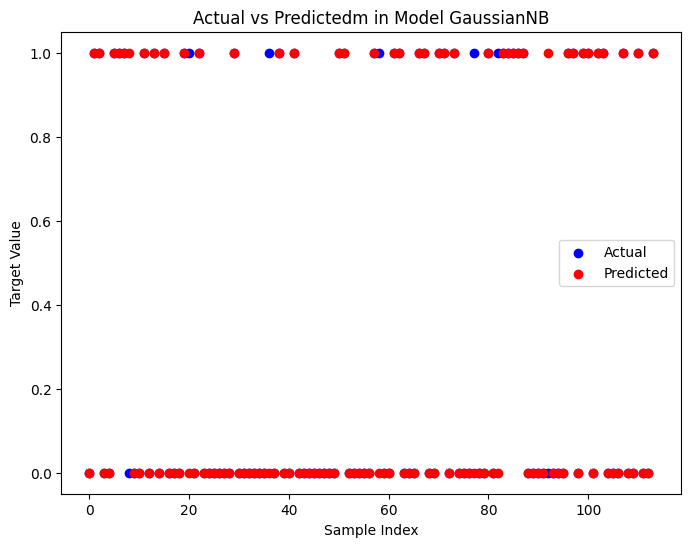

In [75]:
na=models[0]

plot_actual_vs_predicted(y_test, y_p_test1,na)

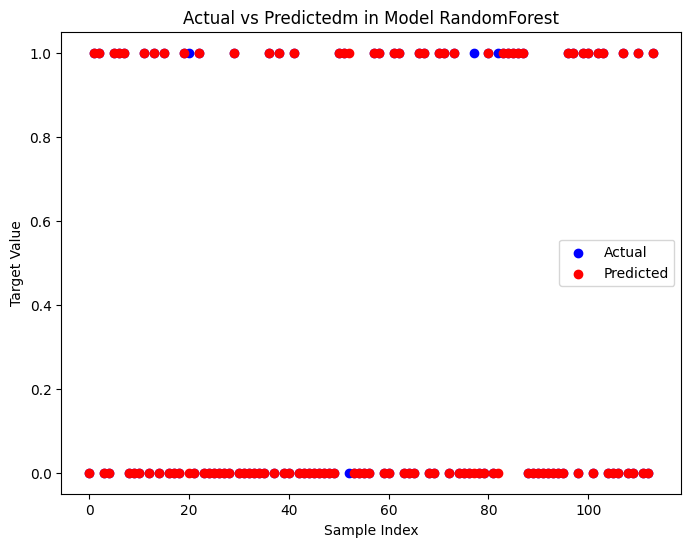

In [76]:
na=models[1]

plot_actual_vs_predicted(y_test, y_p_test2,na)

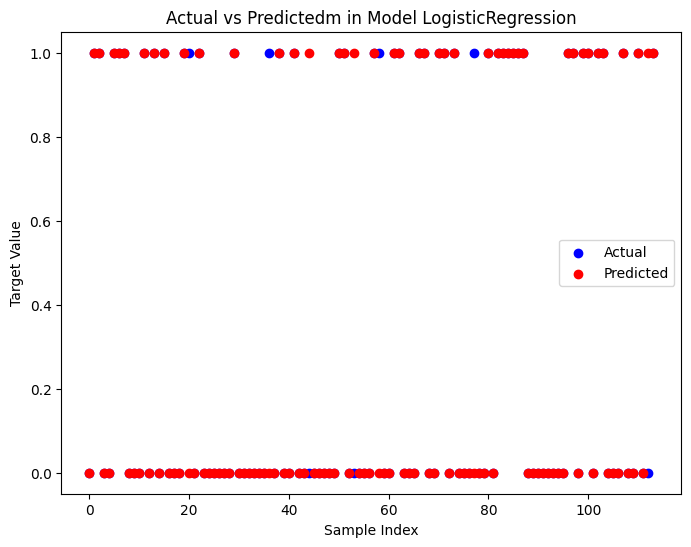

In [77]:
na=models[2]

plot_actual_vs_predicted(y_test, y_p_test3,na)

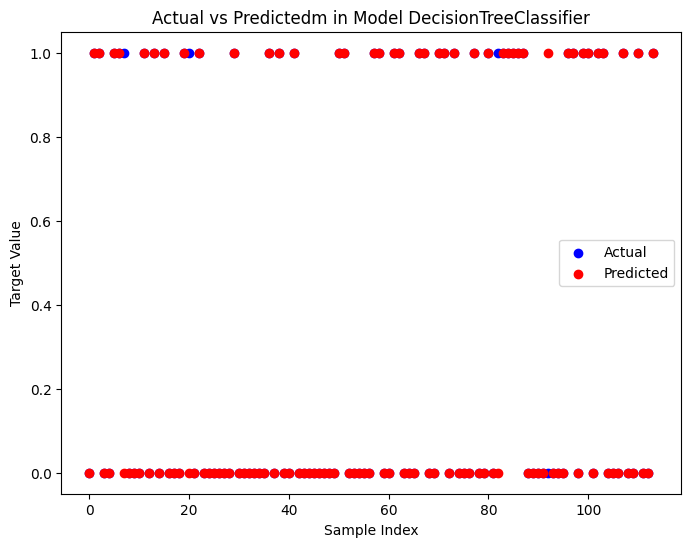

In [78]:
na=models[3]

plot_actual_vs_predicted(y_test, y_p_test4,na)

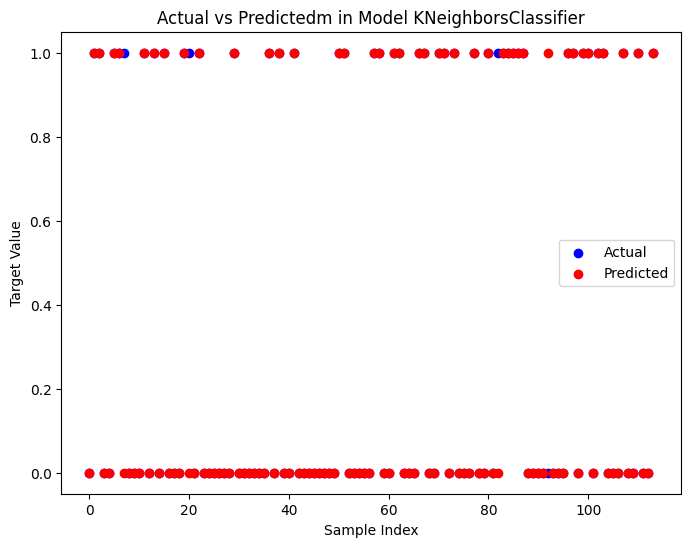

In [79]:
na=models[4]

plot_actual_vs_predicted(y_test, y_p_test4,na)

It has been seen here that the **Decision Tree** model predicted the data better

In [80]:
clf = DecisionTreeRegressor()

clf = clf.fit(X0,y)

In [81]:
# number=int(input('Enter a number: '))

In [82]:
list_numbers=[]

for i in range(number):

    print(f'------list {i+1}--------')

    

    num1=float(input('Enter a number Radius: '))

    num2=float(input('Enter a number Texture: '))

    num3=float(input('Enter a number Perimeter: '))

    num4=float(input('Enter a number Area: '))

    num5=float(input('Enter a number Smoothness: '))

    num6=float(input('Enter a number Compactness: '))

    num7=float(input('Enter a number Concavity: '))

    num8=float(input('Enter a number Concave Points: '))

    num9=float(input('Enter a number Symmetry: '))

    num10=float(input('Enter a number Fractal Dimension: '))

    

    lists=[num1,num2,num3,num4,num5,num6,num7,num8,num9,num10]

    list_numbers.append(lists) 

NameError: name 'number' is not defined

In [ ]:
new_data = list_numbers

answer = clf.predict(new_data)

In [ ]:
for i in range(len(new_data)):

    if answer[i]==1:

        print(f'Person: {i+1} ==> Malignant')

    elif answer[i]==0:

        print(f'Person: {i+1} ==> Benign')